#Les bibliothèques

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [7]:
import keras
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout,BatchNormalization
from keras.optimizers import Adam
from keras.callbacks import TensorBoard

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import accuracy_score
from keras.utils import np_utils
import itertools
import os

from PIL import Image
from os import listdir
from os.path import isfile, join
import cv2
import os
from pathlib import Path
from os.path import basename

In [8]:
pip install mtcnn


#Prétraitement+Détection

In [9]:
from mtcnn.mtcnn import MTCNN
def extract_face(filename, required_size=(160, 160)):
    # load image from file
    image = Image.open(filename)
    # convert to RGB
    image = image.convert('RGB')
    # convert to array
    pixels = np.asarray(image)
    # create the detector, using default weights
    detector = MTCNN()
    # detect faces in the image
    results = detector.detect_faces(pixels)
    # extract the bounding box from the first face
    x1, y1, width, height = results[0]['box']
    # deal with negative pixel index
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = np.asarray(image)
    return face_array

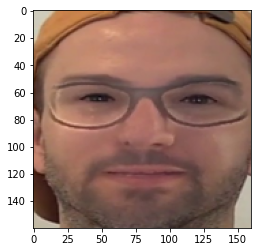

In [ ]:
fc=extract_face('/content/drive/My Drive/Split/val/Locas/Locas714.jpg')

plt.imshow(fc)

In [10]:
def load_face(dir):
    faces = list()
    for filename in os.listdir(dir):
        path = dir + filename
        face = extract_face(path)
        faces.append(face)
    return faces

def load_dataset(dir):
    # list for faces and labels
    X, y = list(), list()
    for subdir in os.listdir(dir):
        path = dir + subdir + '/'
        faces = load_face(path)
        labels = [subdir for i in range(len(faces))]
        print("loaded %d sample for class: %s" % (len(faces),subdir) ) # print progress
        X.extend(faces)
        y.extend(labels)
    return np.asarray(X), np.asarray(y)

#Téléchargement des données

In [11]:
trainX, trainy = load_dataset('/content/drive/My Drive/train (2)/')
print(trainX.shape, trainy.shape)
testX, testy = load_dataset('/content/drive/My Drive/val (1)/')
print(testX.shape, testy.shape)

np.savez_compressed('/content/drive/My Drive/face_dataset/Faces_dataset.npz', trainX, trainy, testX, testy)

loaded 30 sample for class: elton_john
loaded 36 sample for class: Muhammad_Ali
loaded 32 sample for class: Zinedine_Zidane
loaded 35 sample for class: Angelina_Jolie
loaded 30 sample for class: Bill_Gates
(163, 160, 160, 3) (163,)
loaded 4 sample for class: elton_john
loaded 4 sample for class: Muhammad_Ali
loaded 4 sample for class: Zinedine_Zidane
loaded 4 sample for class: Angelina_Jolie
loaded 4 sample for class: Bill_Gates
(20, 160, 160, 3) (20,)


# Extraction des features

In [ ]:
import numpy as np
data = np.load('/content/drive/My Drive/face_dataset/Faces_dataset.npz') 

x_train = data['arr_0']
x_test = data['arr_2']
y_train= data['arr_1']
y_test= data['arr_3']

In [ ]:
def get_embedding(model, face):
    # scale pixel values
    face = face.astype('float32')
    # standardization
    mean, std = face.mean(), face.std()
    face = (face-mean)/std
    # transfer face into one sample (3 dimension to 4 dimension)
    sample = np.expand_dims(face, axis=0)
    # make prediction to get embedding
    yhat = model.predict(sample)
    return yhat[0]
    
# convert each face in the train set into embedding
emdTrainX = list()
for face in x_train:
    emd = get_embedding(facenet_model, face)
    emdTrainX.append(emd)
    
emdTrainX = np.asarray(emdTrainX)
print(emdTrainX.shape)

# convert each face in the test set into embedding
emdTestX = list()
for face in x_test:
    emd = get_embedding(facenet_model, face)
    emdTestX.append(emd)
emdTestX = np.asarray(emdTestX)
print(emdTestX.shape)

# save arrays to one file in compressed format
np.savez_compressed('/content/drive/My Drive/faces-embeddings.npz', emdTrainX, trainy, emdTestX, testy)

(61, 128)
(19, 128)


# Classification

In [ ]:
from numpy import load
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.svm import SVC
import pickle
# load dataset
data = load('/content/drive/My Drive/faces-embeddings.npz')
trainX, trainy, testX, testy = data['arr_0'], data['arr_1'], data['arr_2'], data['arr_3']
print('Dataset: train=%d, test=%d' % (trainX.shape[0], testX.shape[0]))
# normalize input vectors
in_encoder = Normalizer(norm='l2')
trainX = in_encoder.transform(trainX)
testX = in_encoder.transform(testX)
# label encode targets
out_encoder = LabelEncoder()
out_encoder.fit(trainy)
trainy = out_encoder.transform(trainy)
testy = out_encoder.transform(testy)
# fit model
model = SVC(kernel='linear', probability=True)
model.fit(trainX, trainy)
#Saving Model
filename = 'finalized_model.sav'
pickle.dump(model, open(filename, 'wb'))
# predict
yhat_train = model.predict(trainX)
yhat_test = model.predict(testX)
# score
score_train = accuracy_score(trainy, yhat_train)
score_test = accuracy_score(testy, yhat_test)
# summarize
print('Accuracy: train=%.3f, test=%.3f' % (score_train*100, score_test*100))

Dataset: train=61, test=19
Accuracy: train=100.000, test=100.000


# Images

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:341: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


Prediction Probablity:100.000


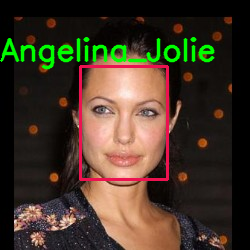

In [ ]:
from numpy import expand_dims
import cv2
from sklearn.preprocessing import LabelEncoder
from mtcnn.mtcnn import MTCNN
from keras.models import load_model
import numpy as np
from google.colab.patches import cv2_imshow

model = load_model('/content/drive/My Drive/facenet1/facenet_keras.h5')
#print("FaceNet Model Loaded")
emb=[]

names=["Angelina_Jolie","Bill_Gates","John_Snow","Muhammad_Ali","Zinedine_Zidane","elton_john"]
imageName="/content/drive/My Drive/face_dataset/val/Angelina_Jolie/Angelina_Jolie_0006.jpg"
   # print (imageName)
image = cv2.imread(imageName)
    
    #Resizing image to fit window
scale_percent = 80 # percent of original size
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
dim = (width, height)
resized_image = cv2.resize(image,dim, interpolation = cv2.INTER_AREA)
    #using mtcnn for face detection
detector = MTCNN()
    #using detect faces function to retrive box, confidence and landmarks of faces
results = detector.detect_faces(image)
    #if face not detected just skip the image
if (results==[]):
    print("Face Not Detected")
        
   # print("1. Face Detected form image")
for loc in results:
  out_encoder = LabelEncoder()
  x1, y1, width, height = loc['box']
  cv2.rectangle(image, (x1,y1), (x1+width,y1+height), (80,18,236), 2)
  x1, y1 = abs(x1), abs(y1)
  x2, y2 = x1 + width, y1 + height
    # extract the face
  face = image[y1:y2, x1:x2]
     # print("2. Face extracted")
    #resized for FaceNet model
  face = cv2.resize(face,(160,160))
  face = face.astype('float32')
  mean, std = face.mean(), face.std()
  face = (face - mean) / std
    
  face = expand_dims(face, axis=0)
    #Face embeddings collected
  embed = model.predict(face)
  emb.append(embed)
  filename = 'finalized_model.sav'
  prediction_model = pickle.load(open(filename, 'rb'))
  yhat_class = prediction_model.predict(embed)
    #Retrieving the probability of the prediction
  yhat_prob = prediction_model.predict_proba(embed)
    #print("4. Predicting class and probability done")
    
  class_index = yhat_class[0]
  #print("Index",class_index)
  class_probability = yhat_prob[0,class_index] * 100
  print('Prediction Probablity:%.3f' %(class_probability))
    #setting threshold based on probability
  if(class_probability>99.5):
    cv2.putText(image ,names[class_index],(0,60), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,0),2,cv2.LINE_AA)
    cv2_imshow(image)
    cv2.waitKey(0)
  else:
        #print("Person not matched")
    cv2.putText(image,"unknown",(10,30), cv2.FONT_HERSHEY_SIMPLEX, 0,(0,255,0),1,cv2.LINE_AA)
    cv2_imshow(image)
    cv2.waitKey(0)

cv2.destroyAllWindows()



# Videos

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:341: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


Prediction Probablity:100.000


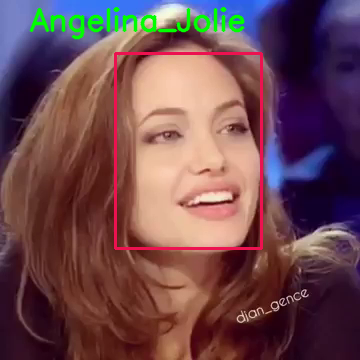

Prediction Probablity:100.000


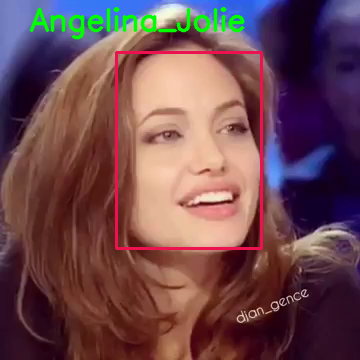

Prediction Probablity:100.000


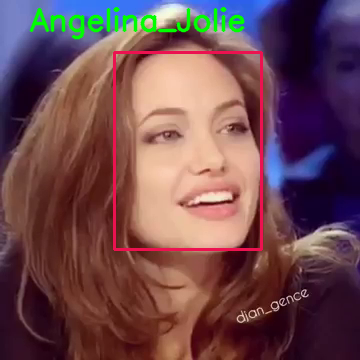

Prediction Probablity:100.000


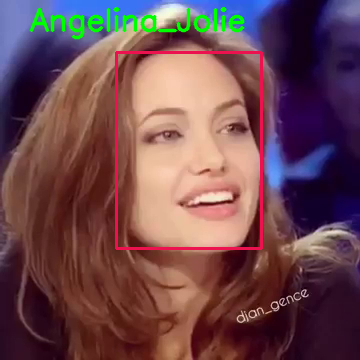

Prediction Probablity:100.000


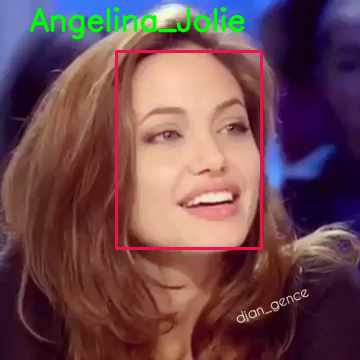

Prediction Probablity:100.000


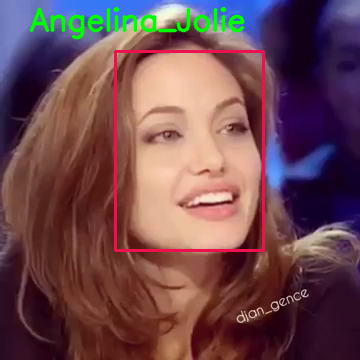

Prediction Probablity:100.000


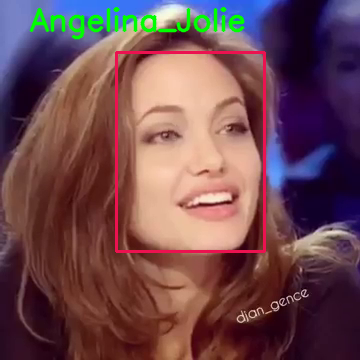

Prediction Probablity:100.000


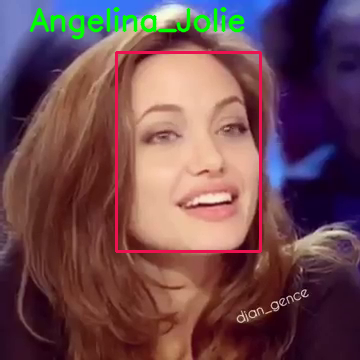

Prediction Probablity:100.000


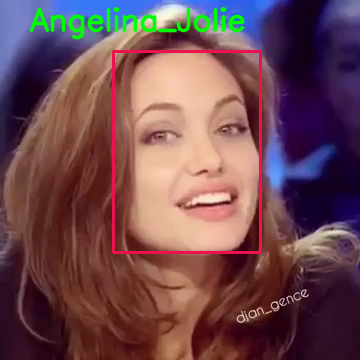

Prediction Probablity:100.000


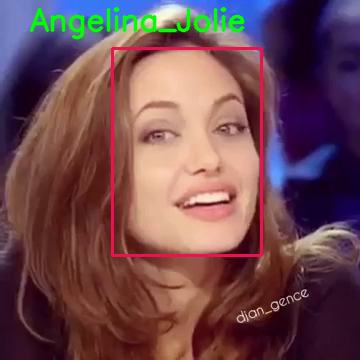

Prediction Probablity:100.000


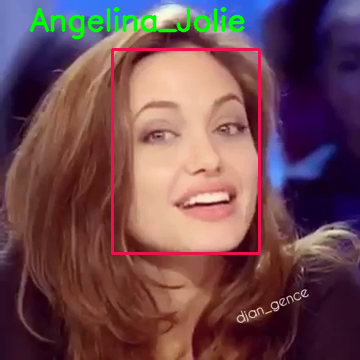

Prediction Probablity:100.000


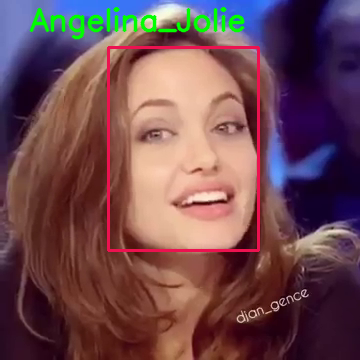

Prediction Probablity:100.000


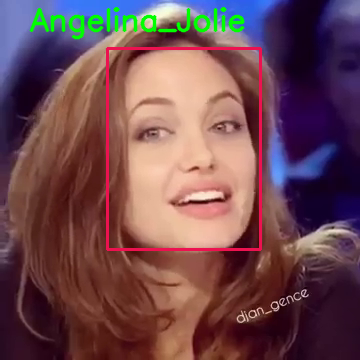

Prediction Probablity:100.000


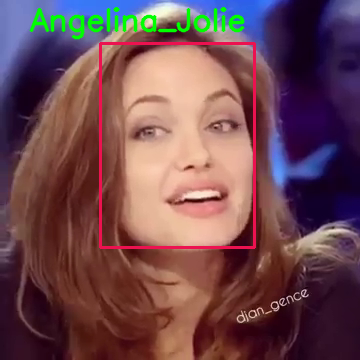

Prediction Probablity:100.000


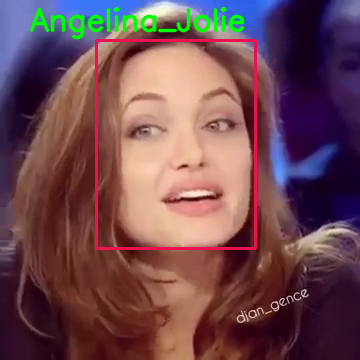

Prediction Probablity:100.000


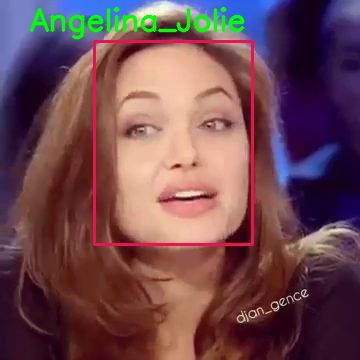

Prediction Probablity:100.000


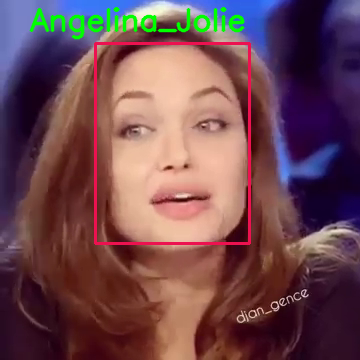

Prediction Probablity:100.000


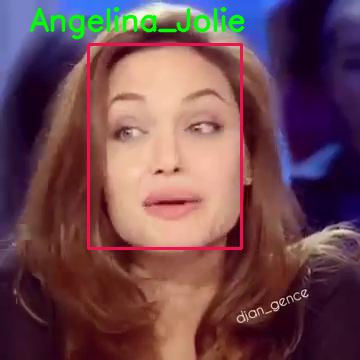

Prediction Probablity:100.000


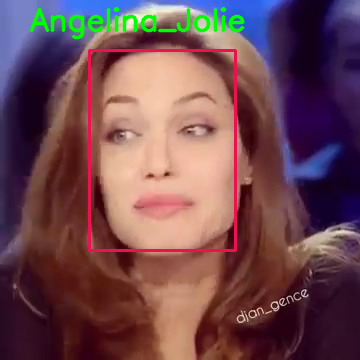

Prediction Probablity:100.000


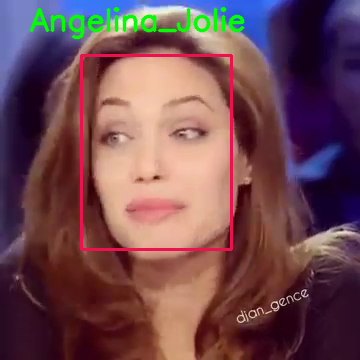

Prediction Probablity:100.000


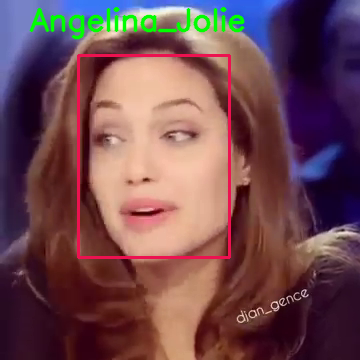

Prediction Probablity:100.000


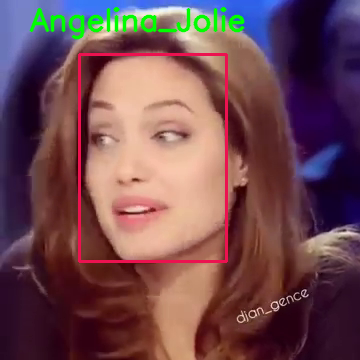

Prediction Probablity:100.000


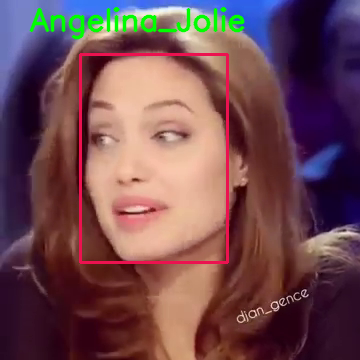

Prediction Probablity:100.000


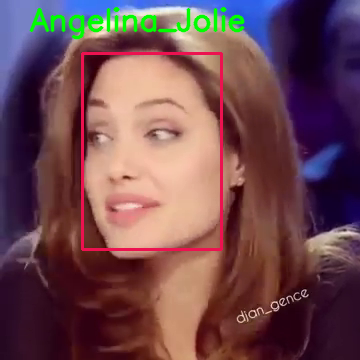

Prediction Probablity:100.000


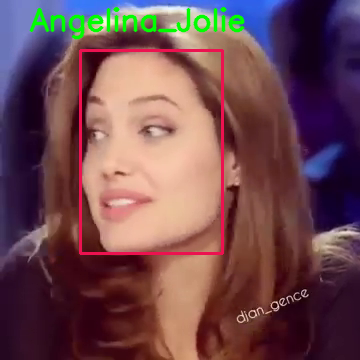

Prediction Probablity:100.000


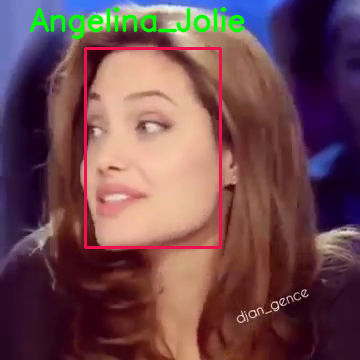

Prediction Probablity:100.000


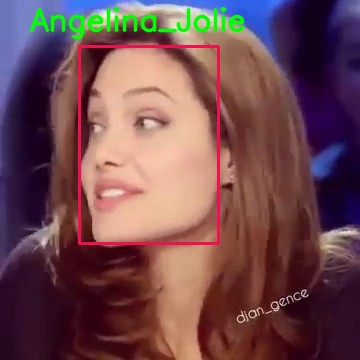

Prediction Probablity:100.000


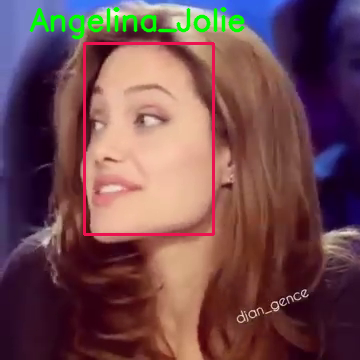

Prediction Probablity:100.000


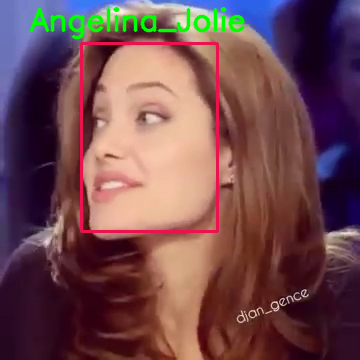

Prediction Probablity:99.998


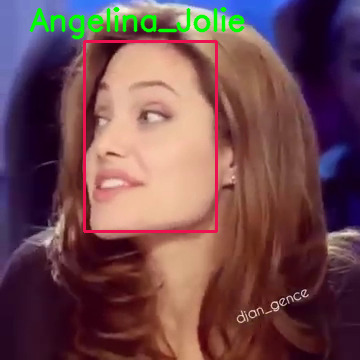

Prediction Probablity:100.000


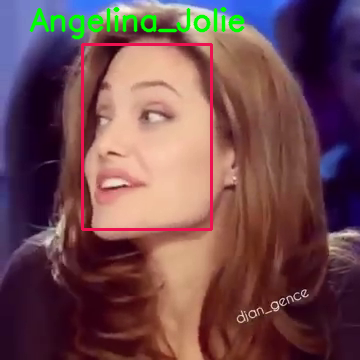

Prediction Probablity:100.000


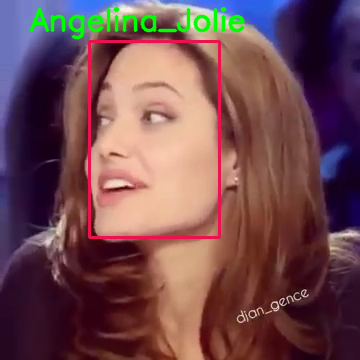

Prediction Probablity:100.000


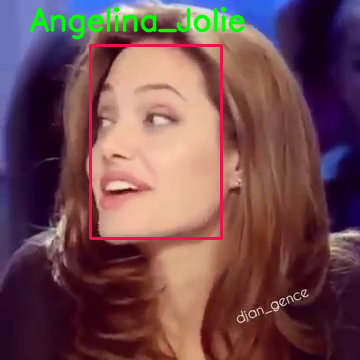

Prediction Probablity:100.000


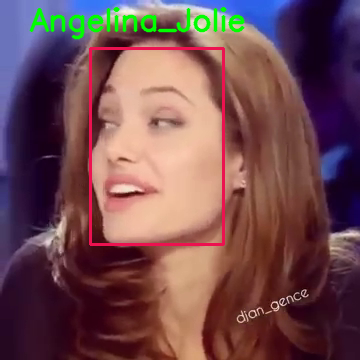

Prediction Probablity:100.000


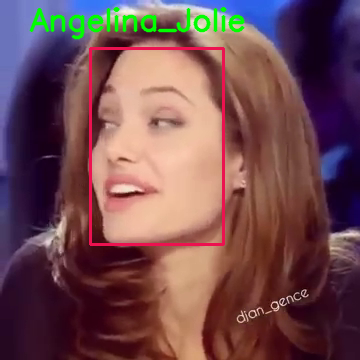

Prediction Probablity:99.997


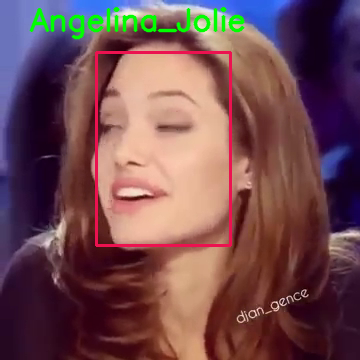

Prediction Probablity:99.995


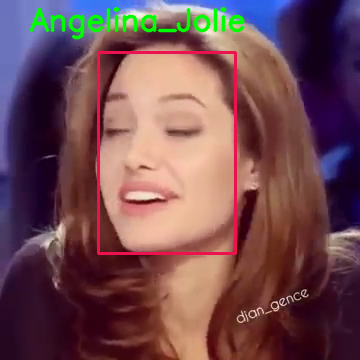

Prediction Probablity:100.000


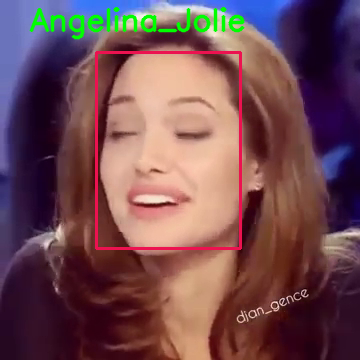

Prediction Probablity:100.000


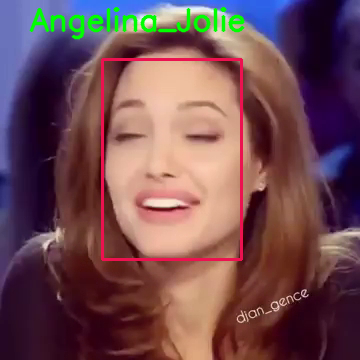

Prediction Probablity:100.000


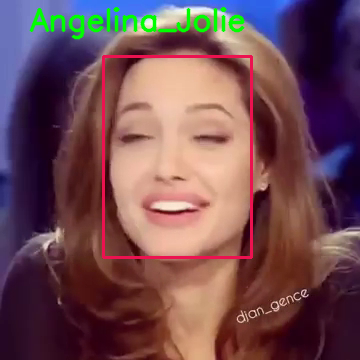

Prediction Probablity:100.000


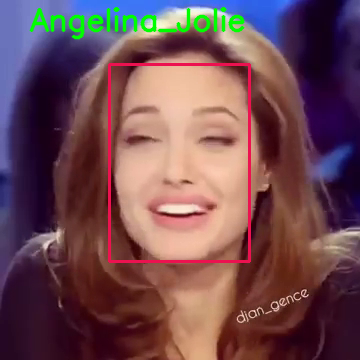

Prediction Probablity:100.000


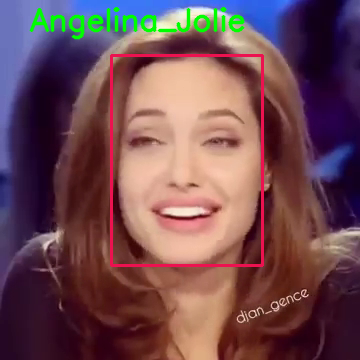

Prediction Probablity:100.000


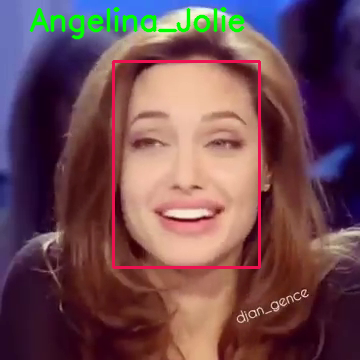

Prediction Probablity:100.000


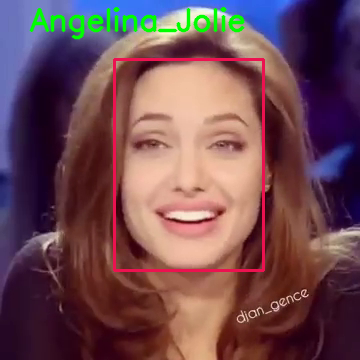

Prediction Probablity:100.000


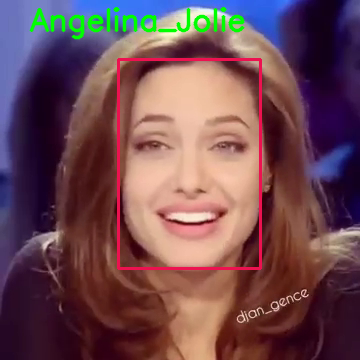

Prediction Probablity:100.000


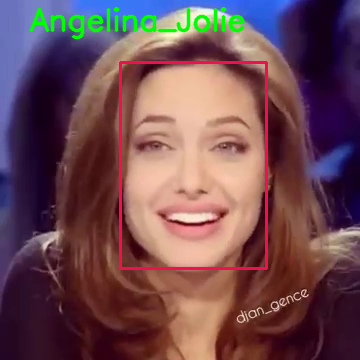

Prediction Probablity:100.000


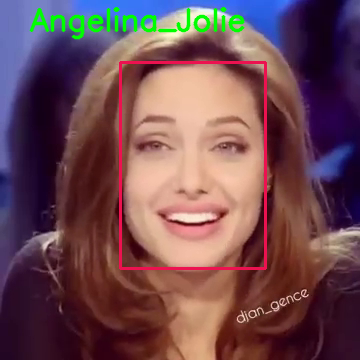

Prediction Probablity:100.000


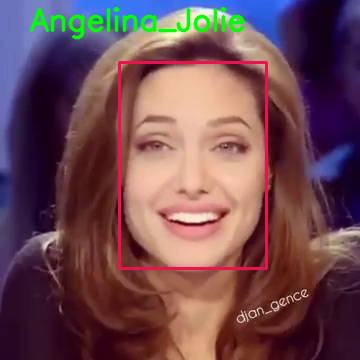

Prediction Probablity:100.000


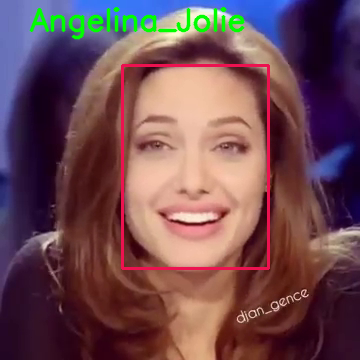

Prediction Probablity:100.000


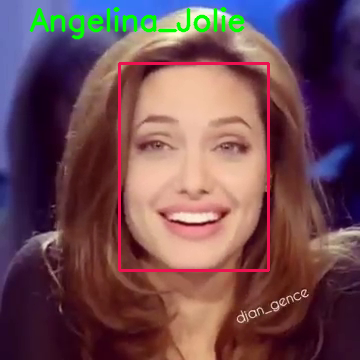

Prediction Probablity:100.000


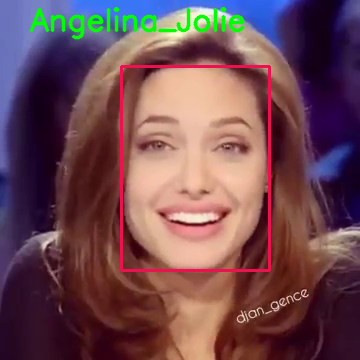

Prediction Probablity:100.000


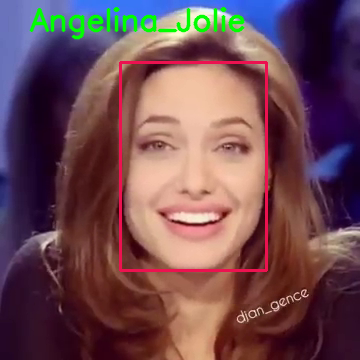

Prediction Probablity:100.000


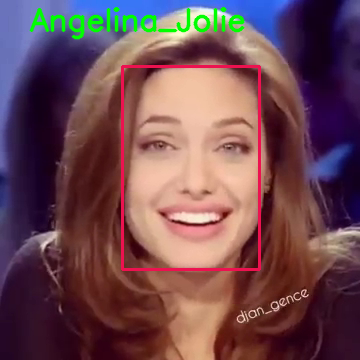

Prediction Probablity:100.000


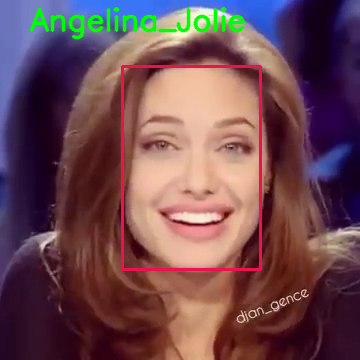

Prediction Probablity:100.000


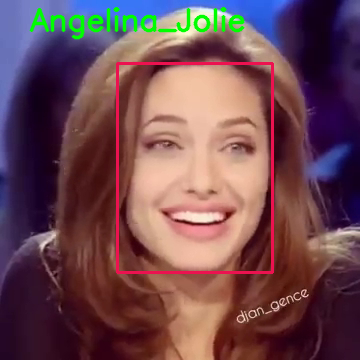

Prediction Probablity:100.000


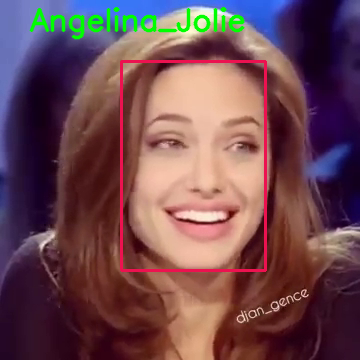

Prediction Probablity:100.000


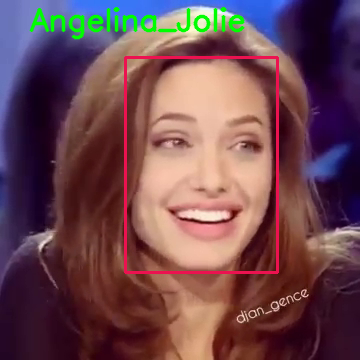

Prediction Probablity:100.000


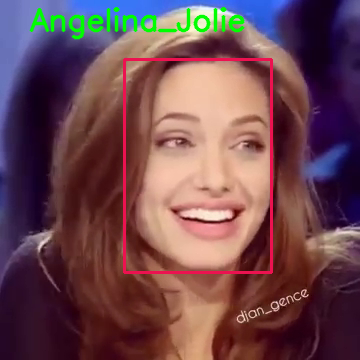

Prediction Probablity:100.000


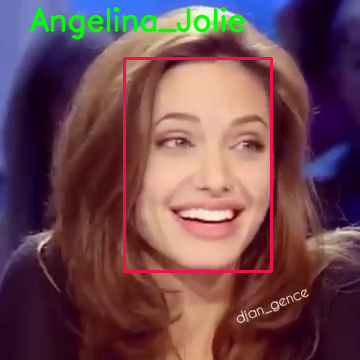

Prediction Probablity:100.000


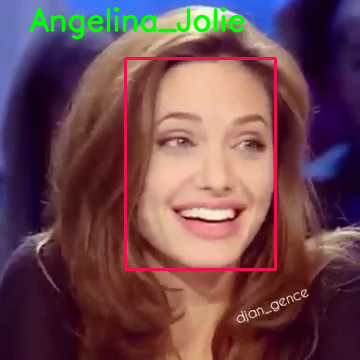

Prediction Probablity:100.000


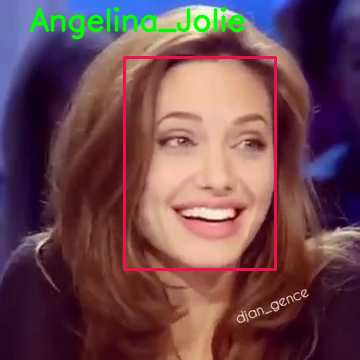

Prediction Probablity:100.000


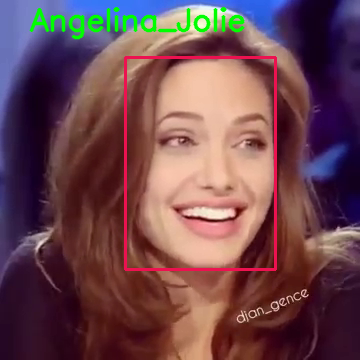

Prediction Probablity:100.000


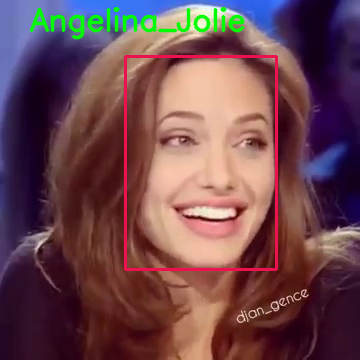

Prediction Probablity:100.000


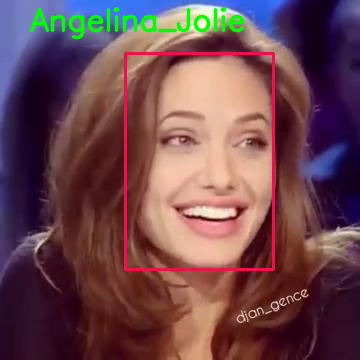

Prediction Probablity:100.000


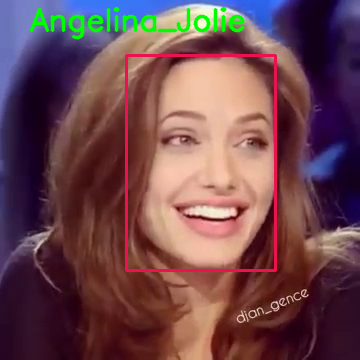

Prediction Probablity:100.000


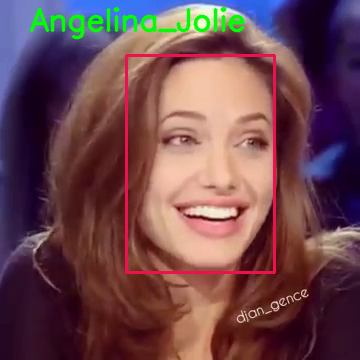

Prediction Probablity:100.000


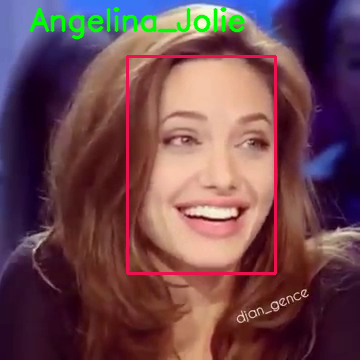

Prediction Probablity:100.000


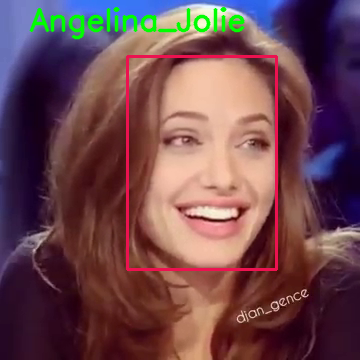

Prediction Probablity:100.000


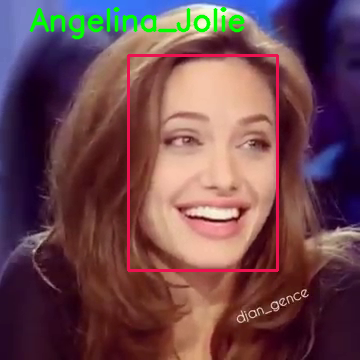

Prediction Probablity:100.000


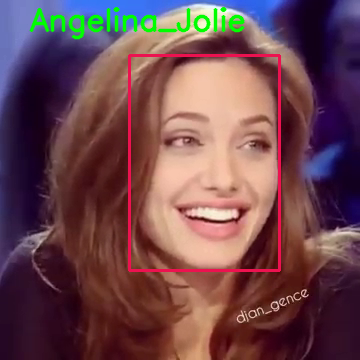

Prediction Probablity:100.000


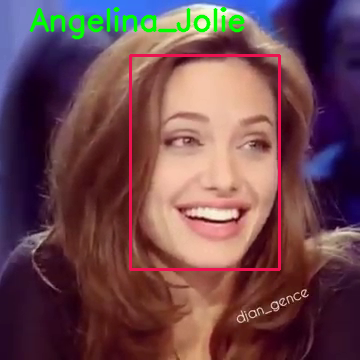

Prediction Probablity:100.000


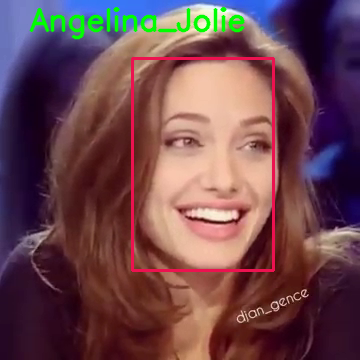

Prediction Probablity:100.000


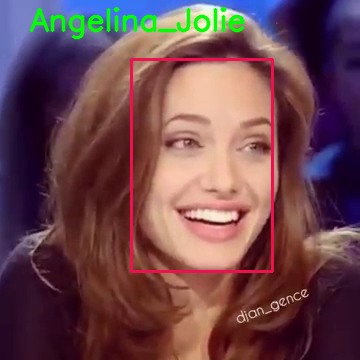

Prediction Probablity:100.000


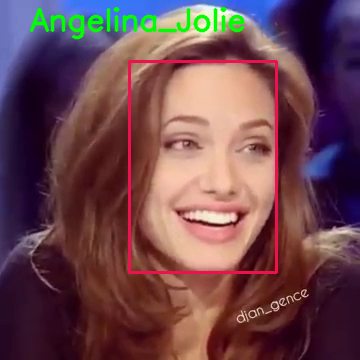

Prediction Probablity:100.000


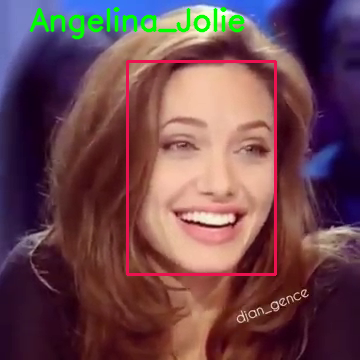

Prediction Probablity:100.000


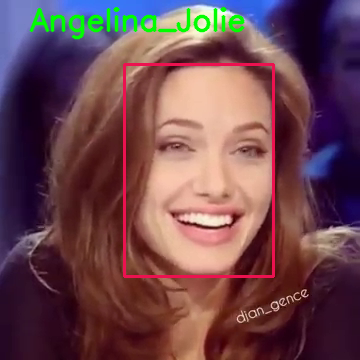

Prediction Probablity:100.000


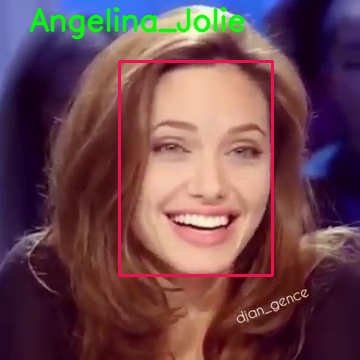

Prediction Probablity:100.000


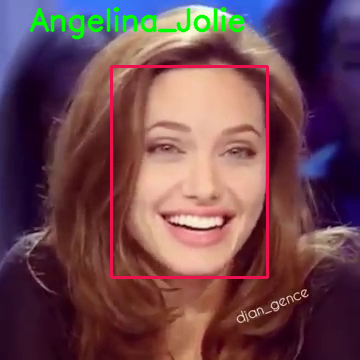

Prediction Probablity:100.000


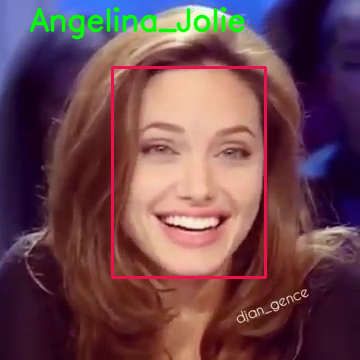

Prediction Probablity:100.000


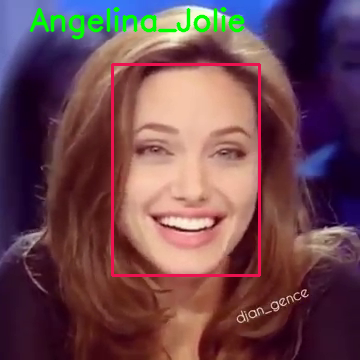

Prediction Probablity:100.000


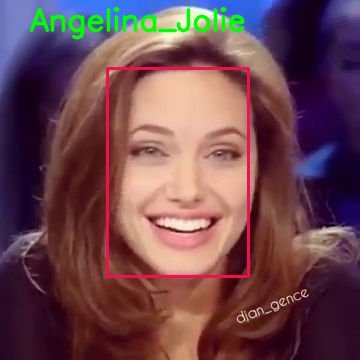

Prediction Probablity:100.000


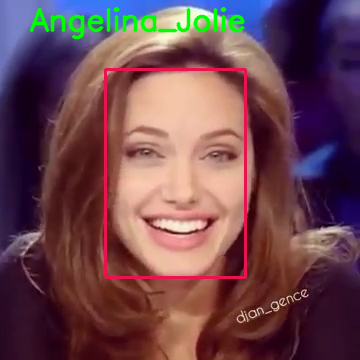

Prediction Probablity:100.000


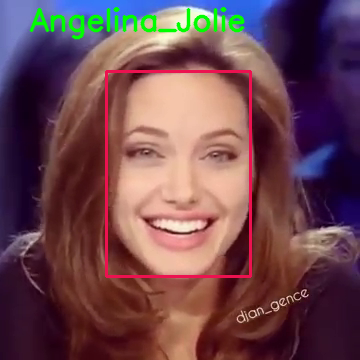

Prediction Probablity:100.000


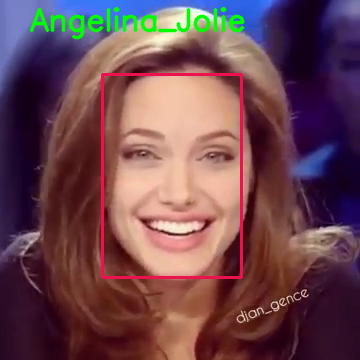

Prediction Probablity:100.000


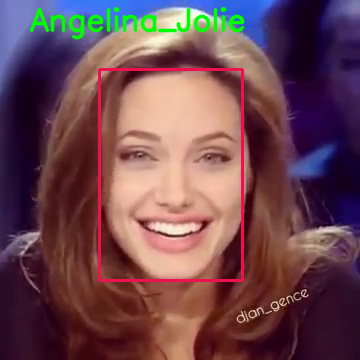

Prediction Probablity:100.000


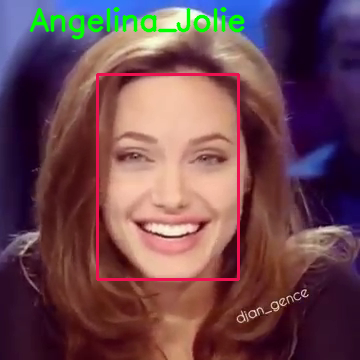

Prediction Probablity:100.000


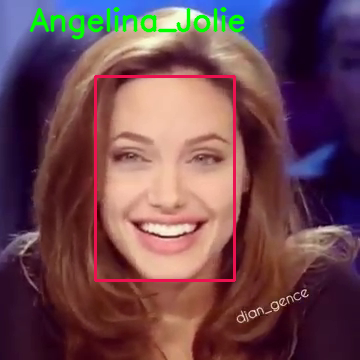

Prediction Probablity:100.000


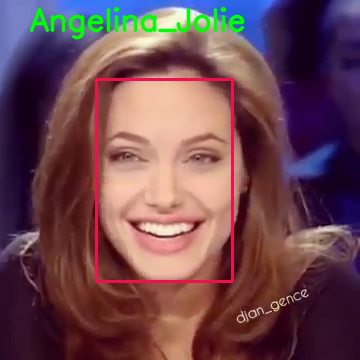

Prediction Probablity:100.000


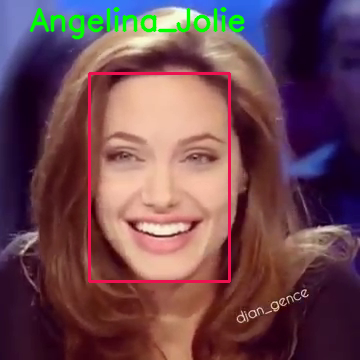

Prediction Probablity:100.000


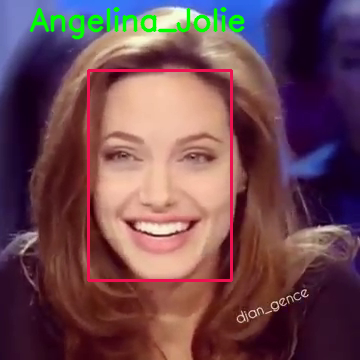

Prediction Probablity:100.000


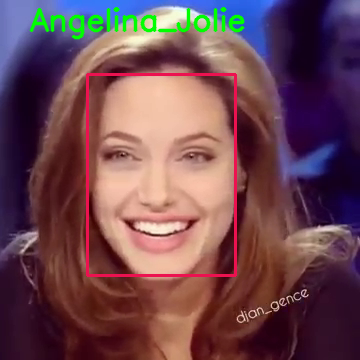

Prediction Probablity:100.000


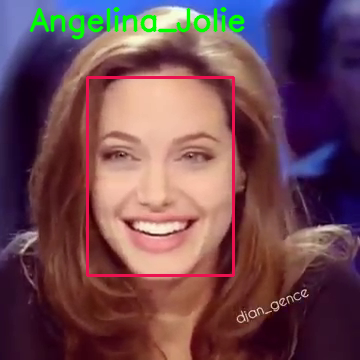

Prediction Probablity:100.000


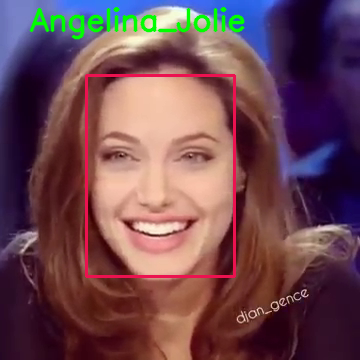

Prediction Probablity:99.986


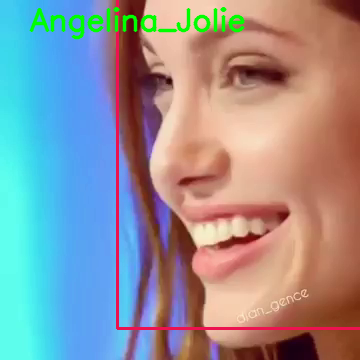

Prediction Probablity:99.987


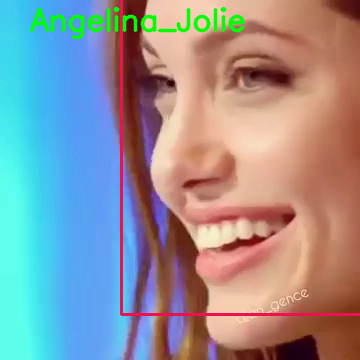

Prediction Probablity:99.985


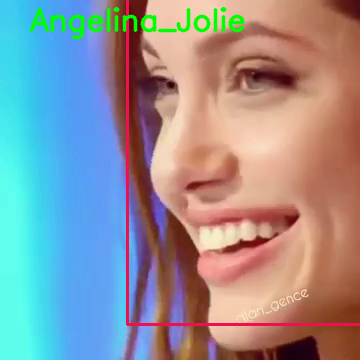

Prediction Probablity:99.995


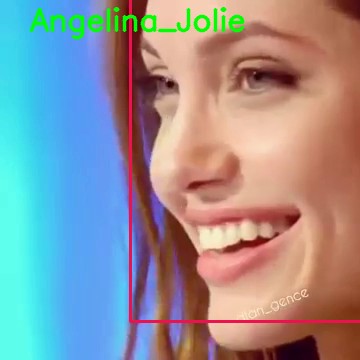

Prediction Probablity:99.995


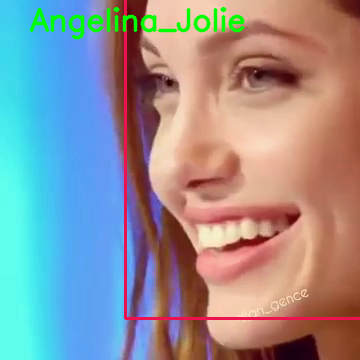

Prediction Probablity:99.988


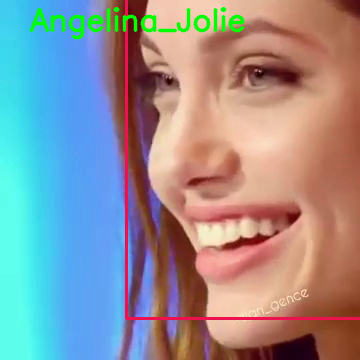

Prediction Probablity:99.989


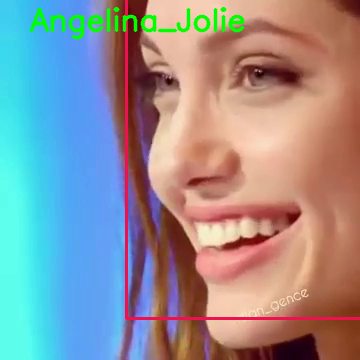

Prediction Probablity:99.980


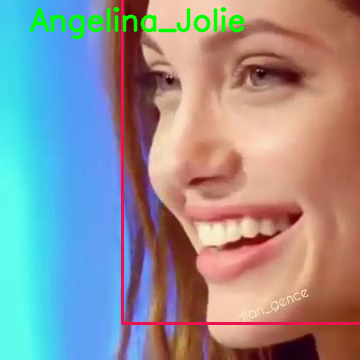

Prediction Probablity:99.998


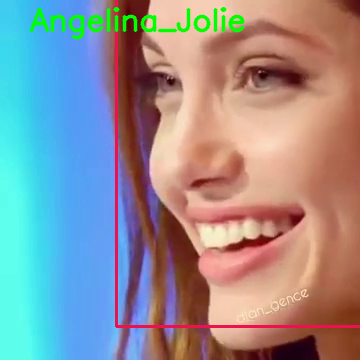

Prediction Probablity:100.000


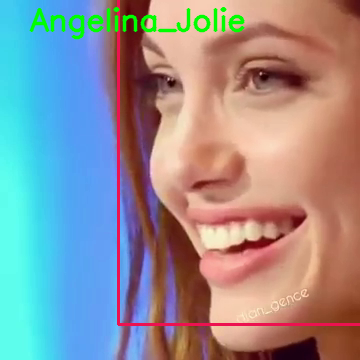

Prediction Probablity:99.999


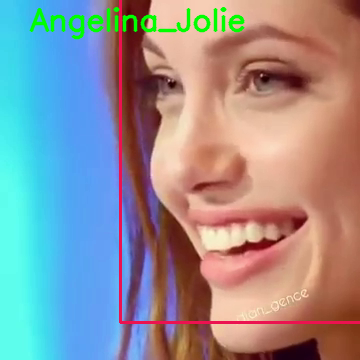

Prediction Probablity:100.000


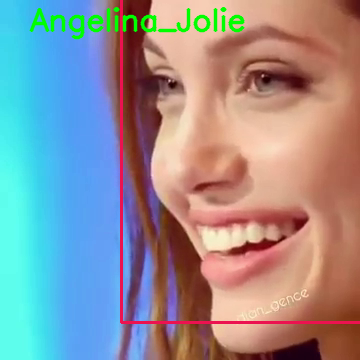

Prediction Probablity:100.000


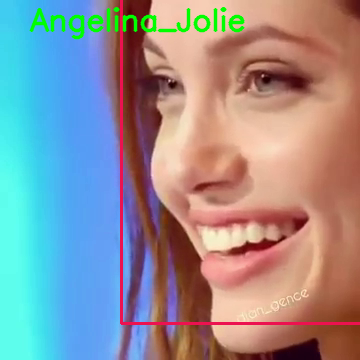

Prediction Probablity:99.997


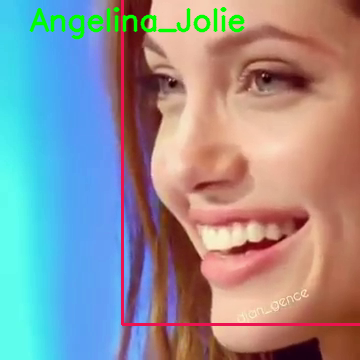

Prediction Probablity:99.996


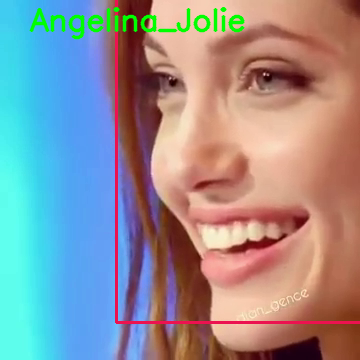

Prediction Probablity:99.999


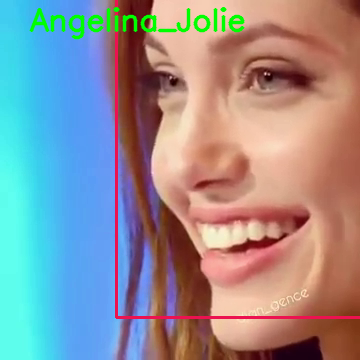

Prediction Probablity:99.994


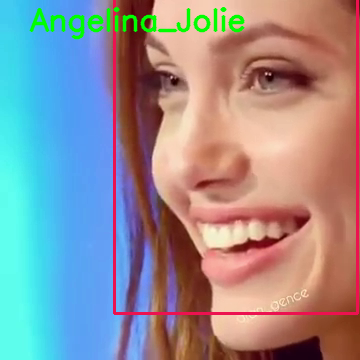

Prediction Probablity:100.000


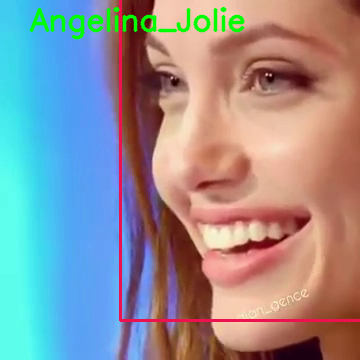

Prediction Probablity:100.000


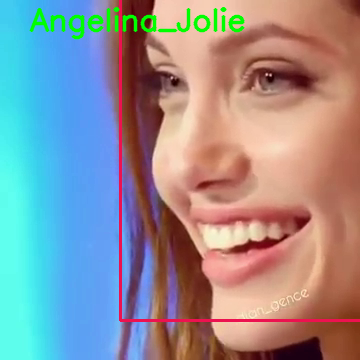

Prediction Probablity:100.000


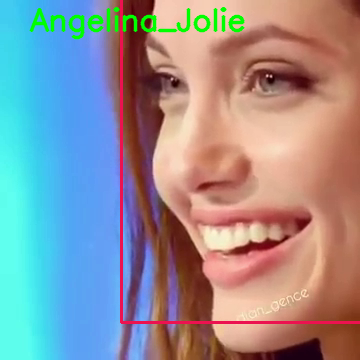

Prediction Probablity:100.000


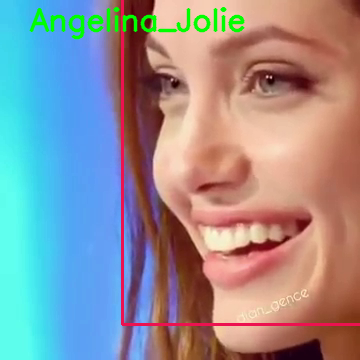

Prediction Probablity:100.000


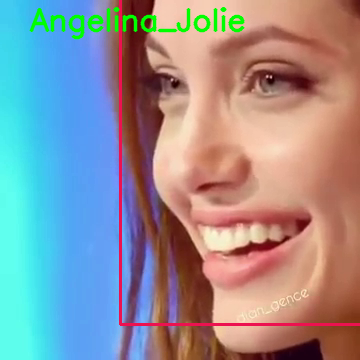

Prediction Probablity:100.000


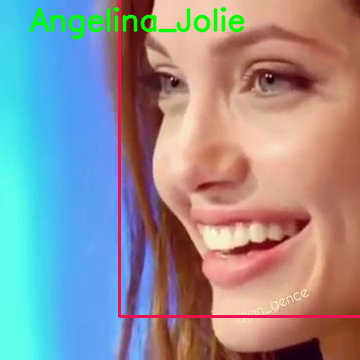

Prediction Probablity:100.000


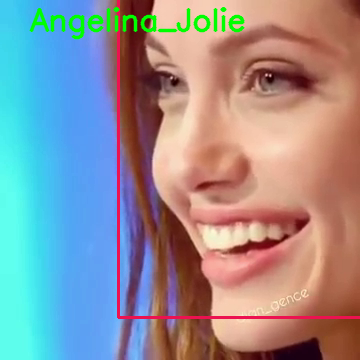

Prediction Probablity:100.000


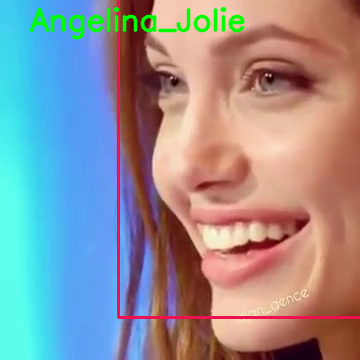

Prediction Probablity:100.000


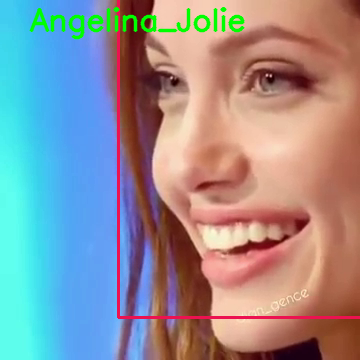

Prediction Probablity:100.000


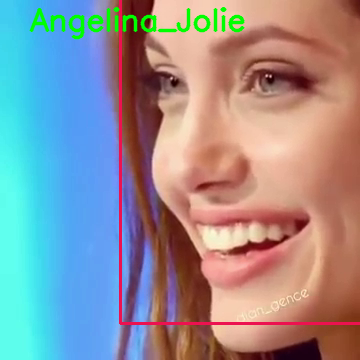

Prediction Probablity:99.999


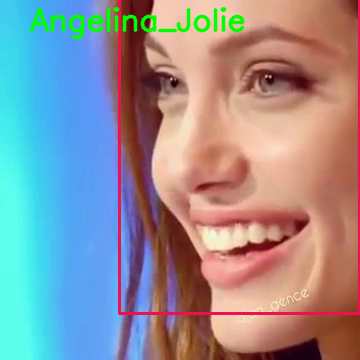

Prediction Probablity:100.000


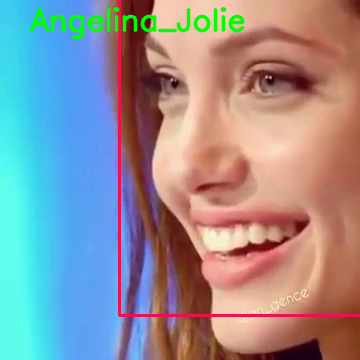

Prediction Probablity:100.000


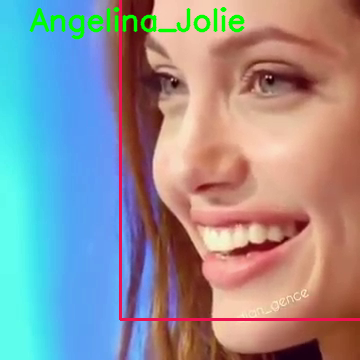

Prediction Probablity:100.000


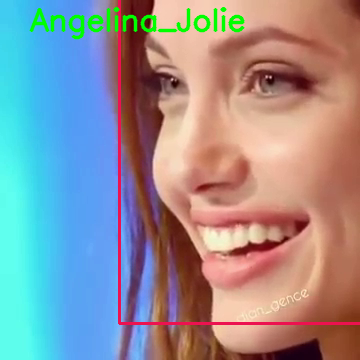

Prediction Probablity:100.000


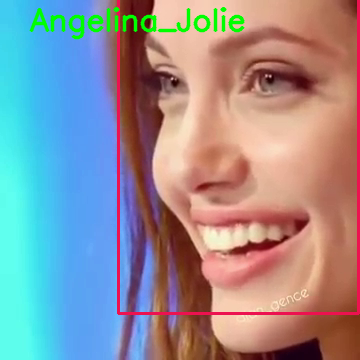

Prediction Probablity:99.999


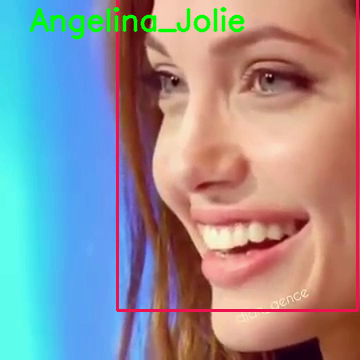

Prediction Probablity:100.000


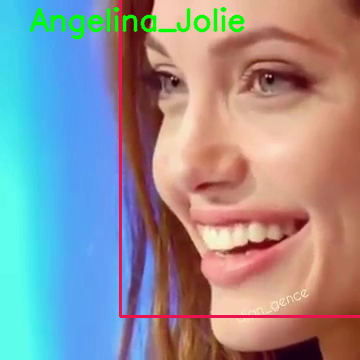

Prediction Probablity:100.000


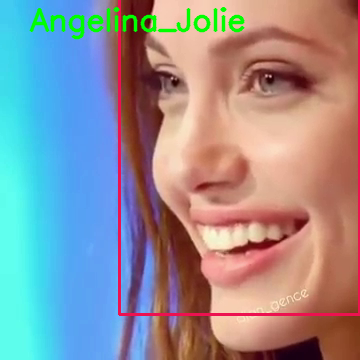

Prediction Probablity:100.000


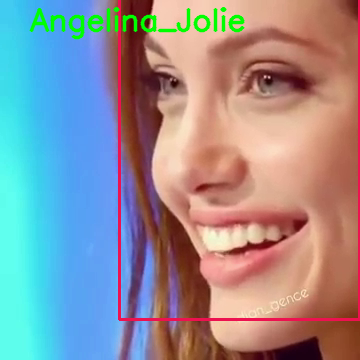

Prediction Probablity:99.999


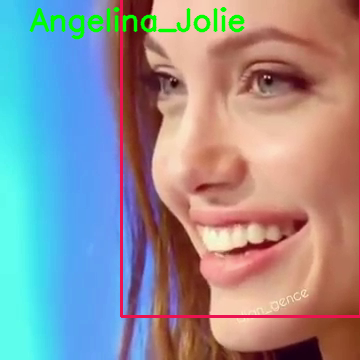

Prediction Probablity:100.000


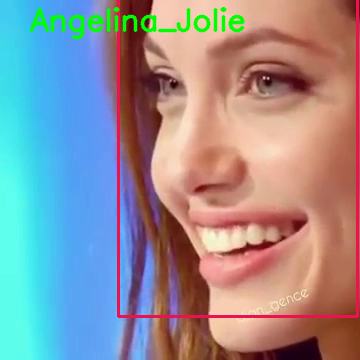

Prediction Probablity:100.000


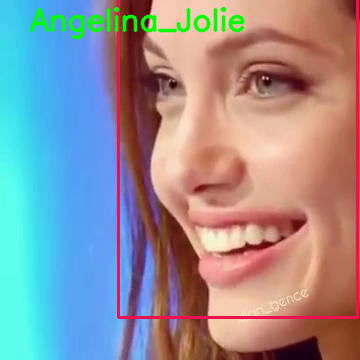

Prediction Probablity:99.999


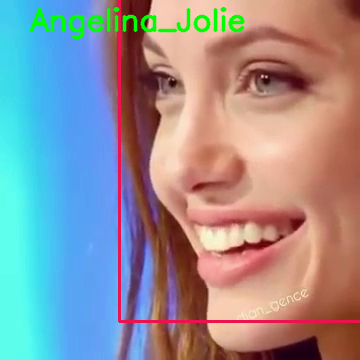

Prediction Probablity:99.999


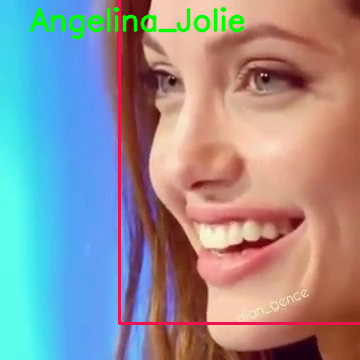

Prediction Probablity:99.998


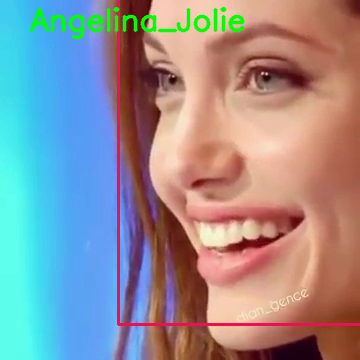

Prediction Probablity:99.998


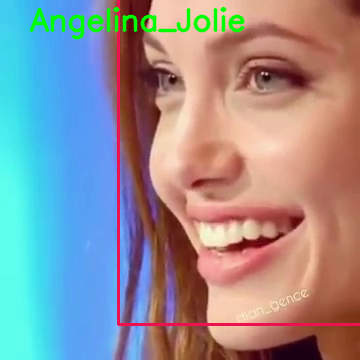

Prediction Probablity:99.998


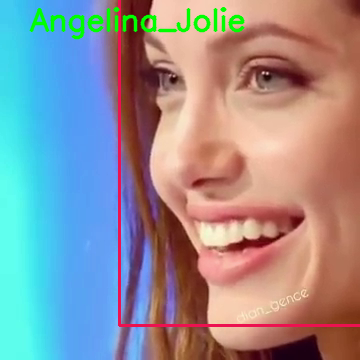

Prediction Probablity:99.997


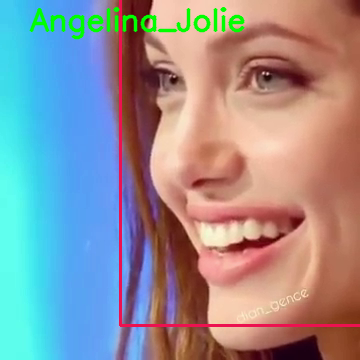

Prediction Probablity:99.994


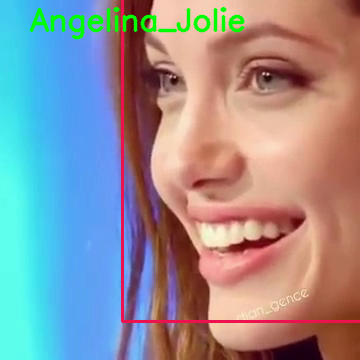

Prediction Probablity:99.996


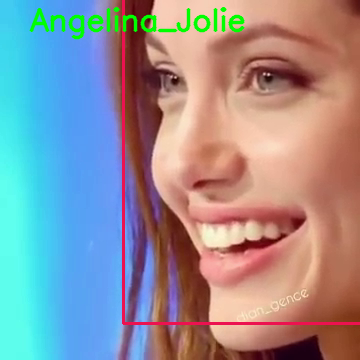

Prediction Probablity:99.997


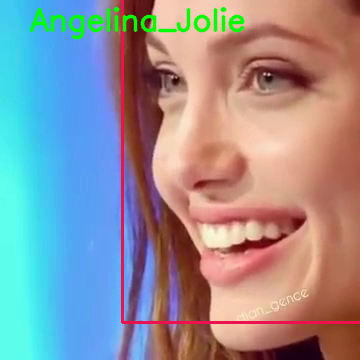

Prediction Probablity:99.997


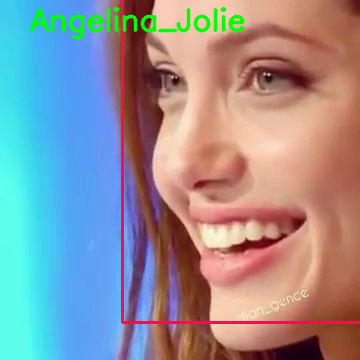

Prediction Probablity:99.998


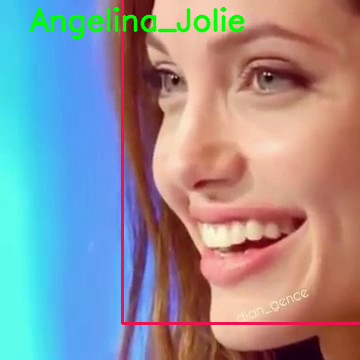

Prediction Probablity:99.998


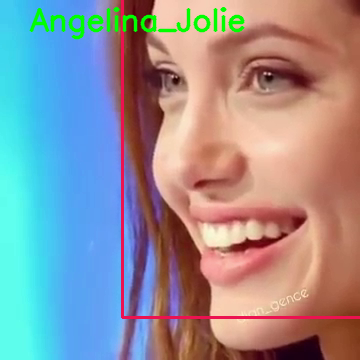

Prediction Probablity:99.997


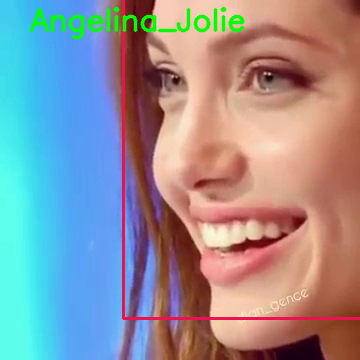

Prediction Probablity:99.998


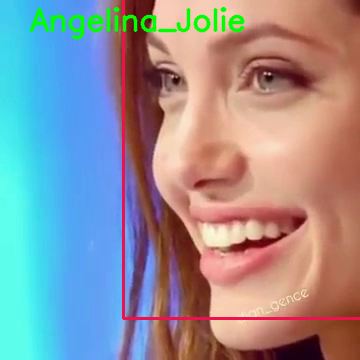

Prediction Probablity:99.998


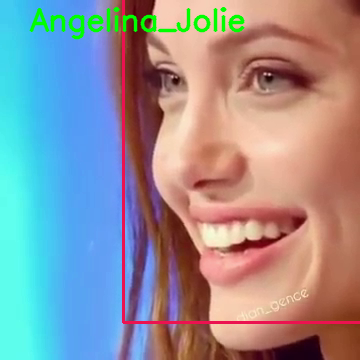

Prediction Probablity:99.999


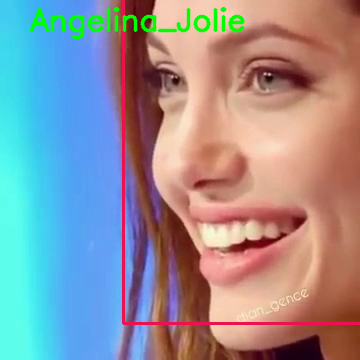

Prediction Probablity:99.998


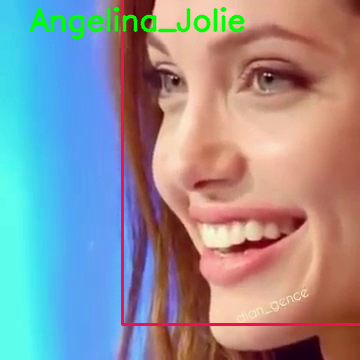

Prediction Probablity:100.000


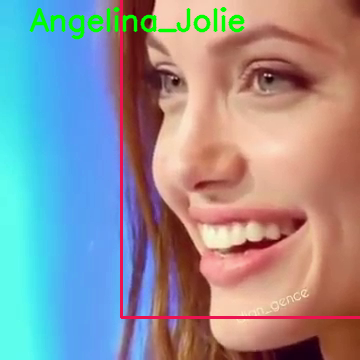

Prediction Probablity:100.000


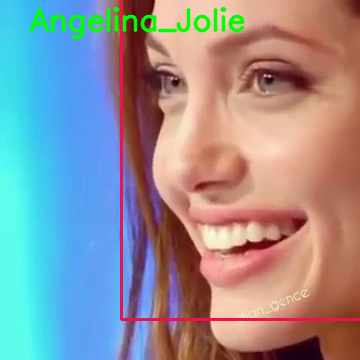

Prediction Probablity:100.000


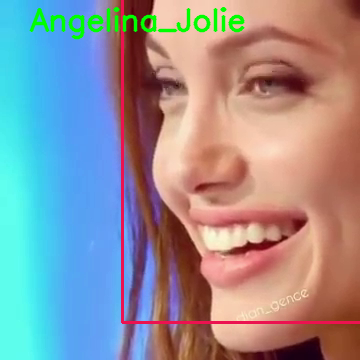

Prediction Probablity:100.000


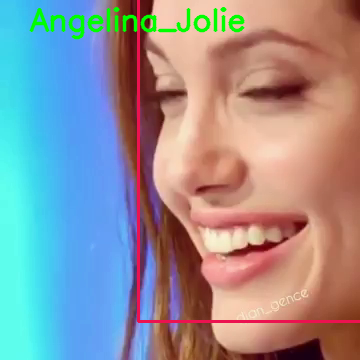

Prediction Probablity:100.000


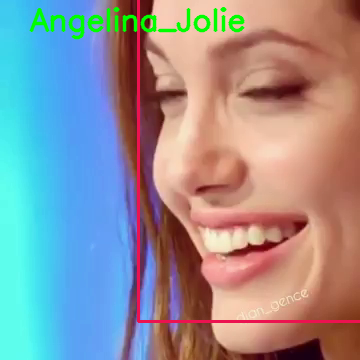

Prediction Probablity:99.995


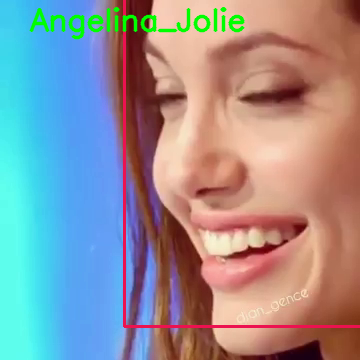

Prediction Probablity:100.000


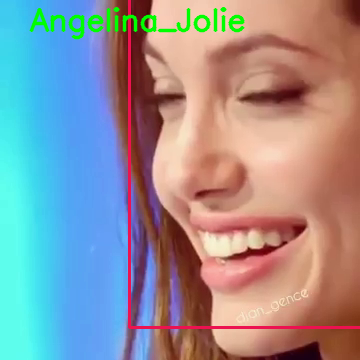

Prediction Probablity:100.000


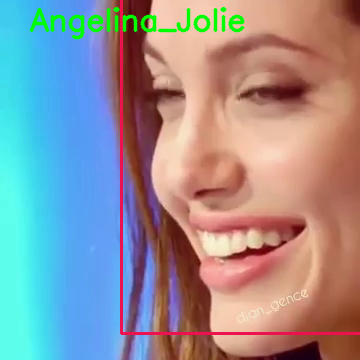

Prediction Probablity:100.000


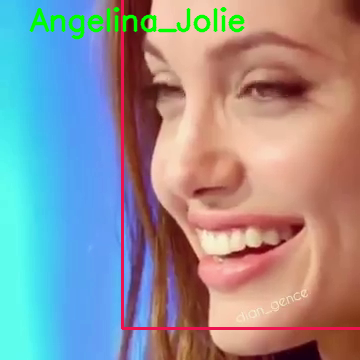

Prediction Probablity:100.000


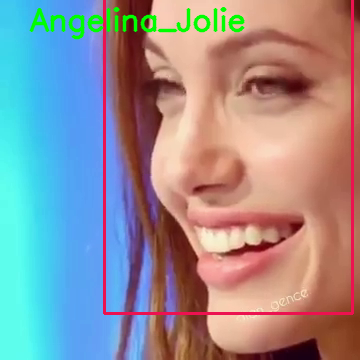

Prediction Probablity:100.000


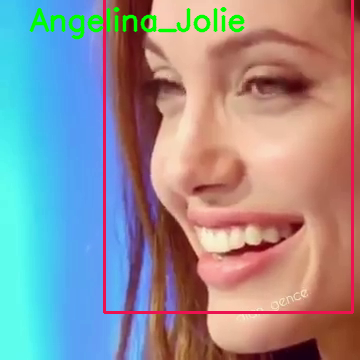

Prediction Probablity:100.000


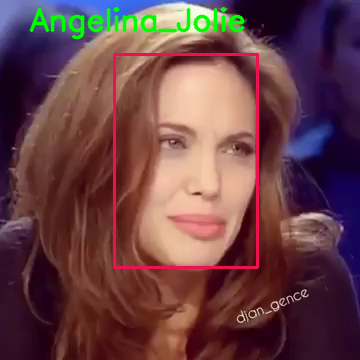

Prediction Probablity:100.000


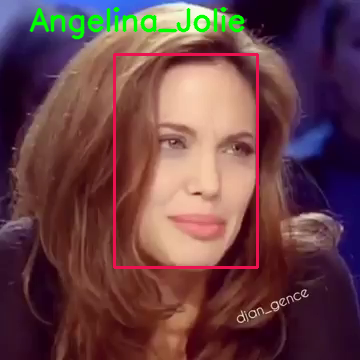

Prediction Probablity:100.000


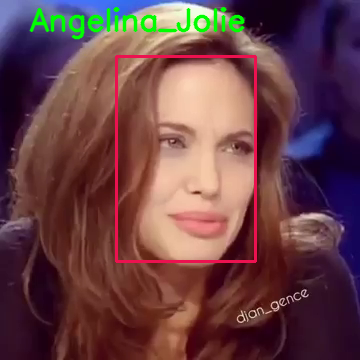

Prediction Probablity:100.000


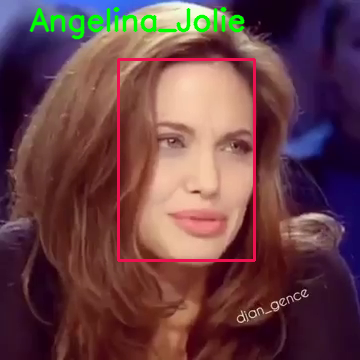

Prediction Probablity:100.000


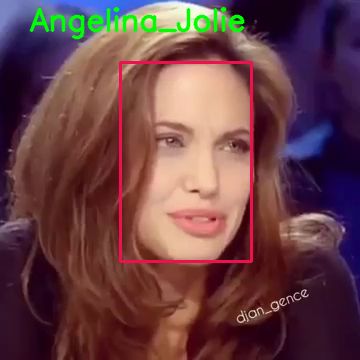

Prediction Probablity:100.000


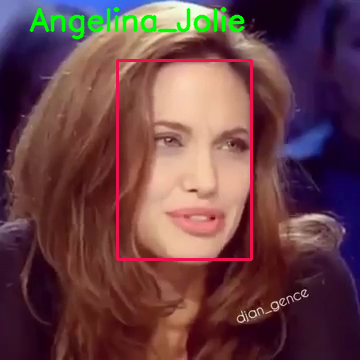

Prediction Probablity:100.000


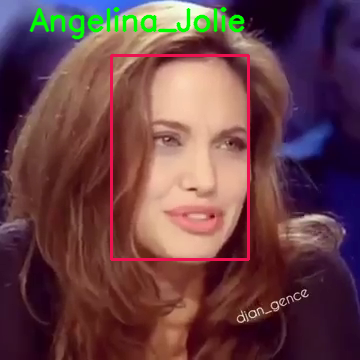

Prediction Probablity:100.000


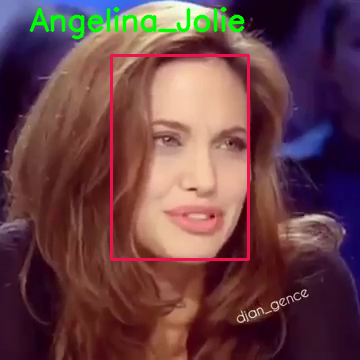

Prediction Probablity:100.000


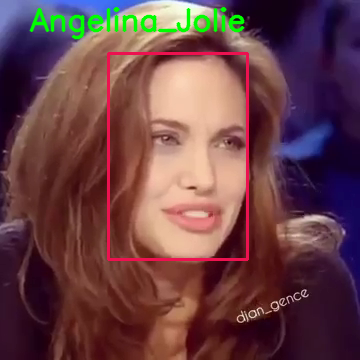

Prediction Probablity:100.000


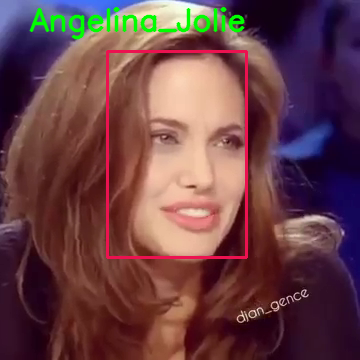

Prediction Probablity:100.000


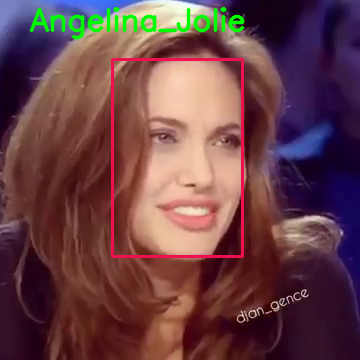

Prediction Probablity:100.000


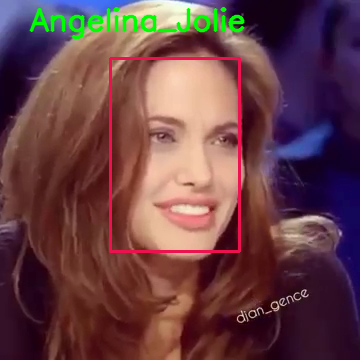

Prediction Probablity:100.000


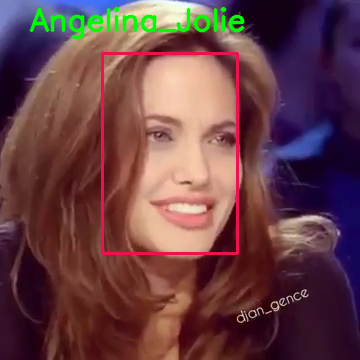

Prediction Probablity:100.000


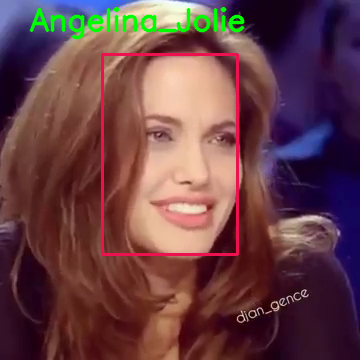

Prediction Probablity:100.000


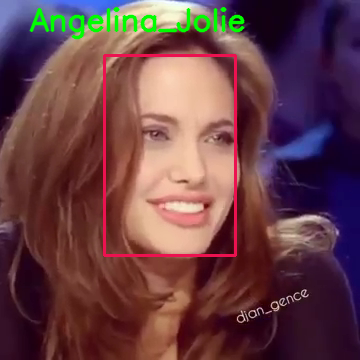

Prediction Probablity:100.000


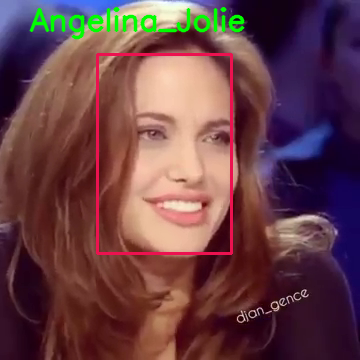

Prediction Probablity:100.000


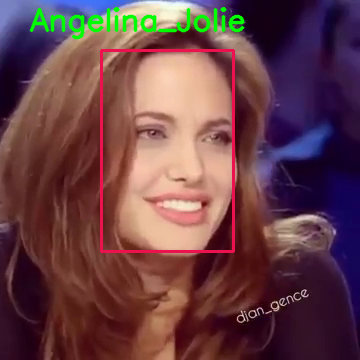

Prediction Probablity:100.000


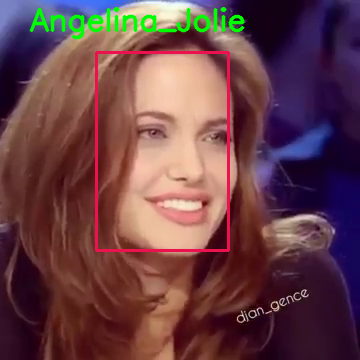

Prediction Probablity:100.000


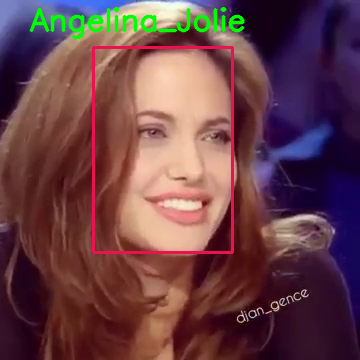

Prediction Probablity:100.000


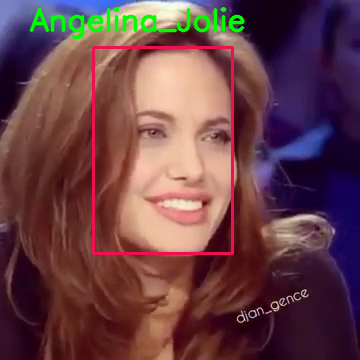

Prediction Probablity:100.000


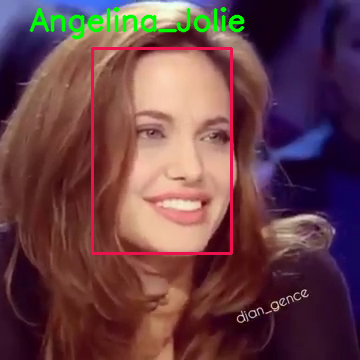

Prediction Probablity:100.000


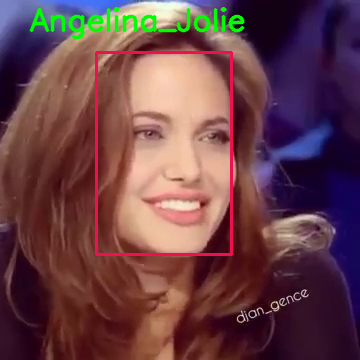

Prediction Probablity:100.000


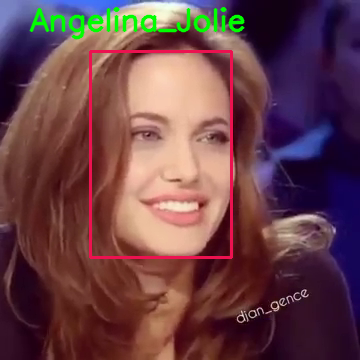

Prediction Probablity:100.000


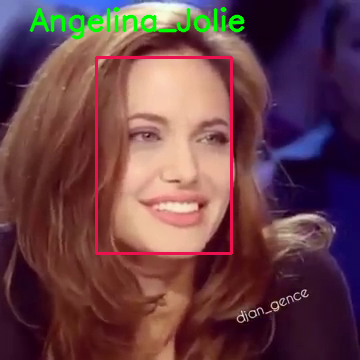

Prediction Probablity:100.000


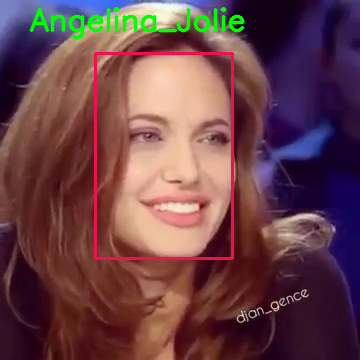

Prediction Probablity:100.000


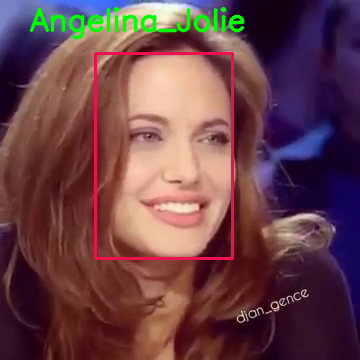

Prediction Probablity:100.000


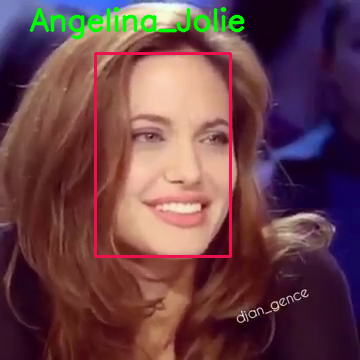

Prediction Probablity:100.000


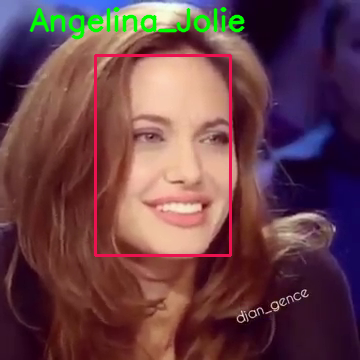

Prediction Probablity:100.000


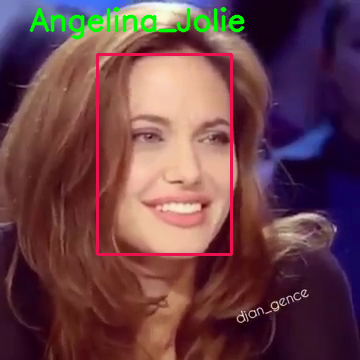

Prediction Probablity:100.000


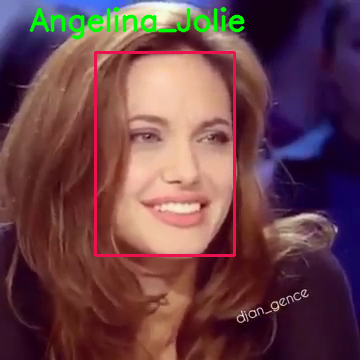

Prediction Probablity:100.000


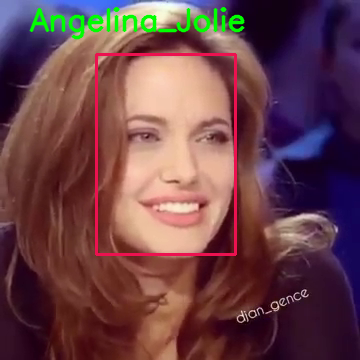

Prediction Probablity:100.000


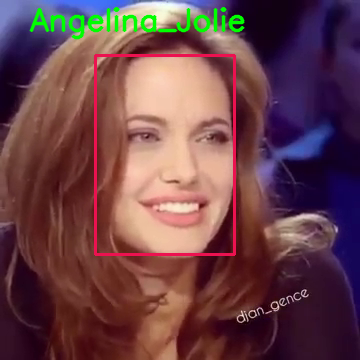

Prediction Probablity:100.000


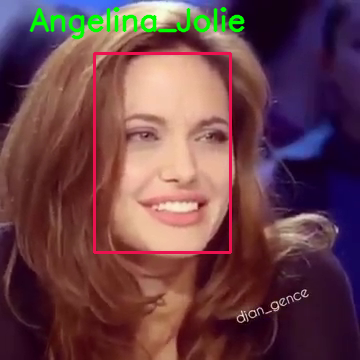

Prediction Probablity:100.000


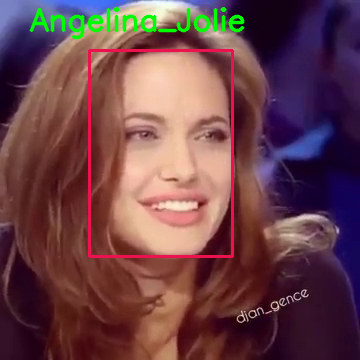

Prediction Probablity:100.000


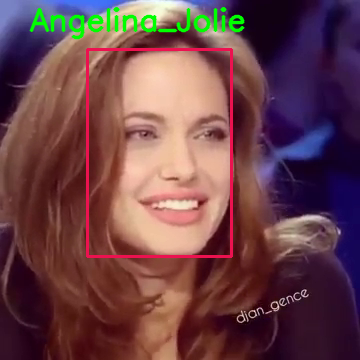

Prediction Probablity:100.000


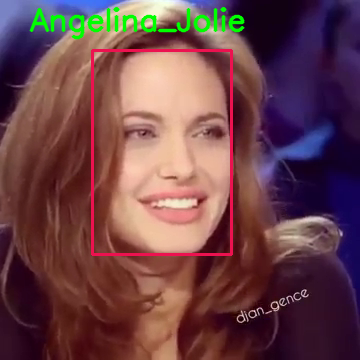

Prediction Probablity:100.000


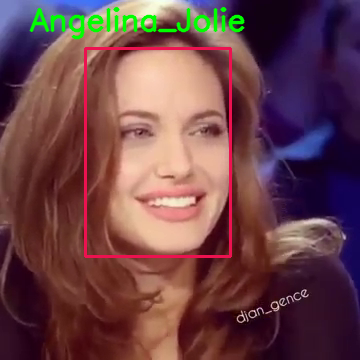

Prediction Probablity:100.000


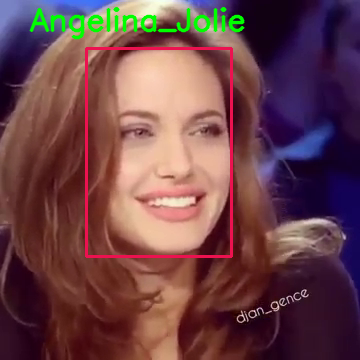

Prediction Probablity:100.000


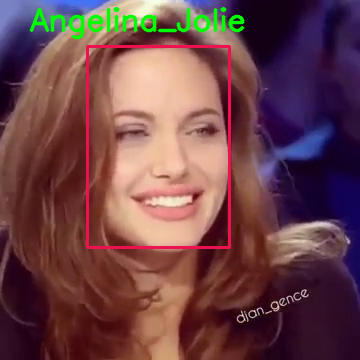

Prediction Probablity:100.000


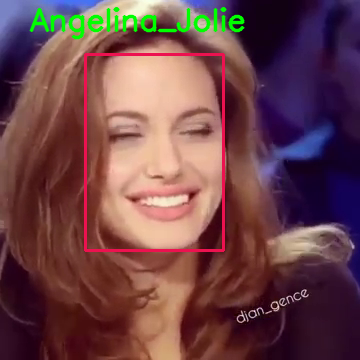

Prediction Probablity:100.000


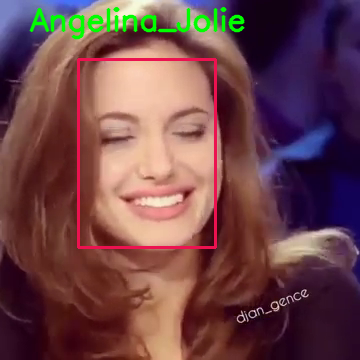

Prediction Probablity:100.000


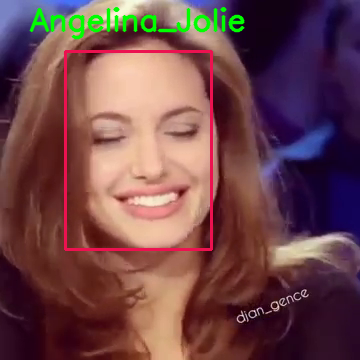

Prediction Probablity:100.000


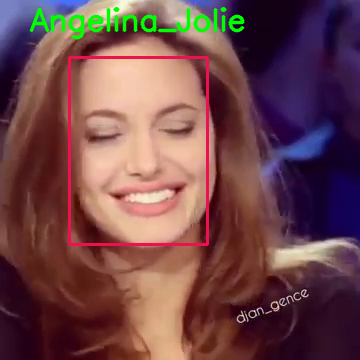

Prediction Probablity:100.000


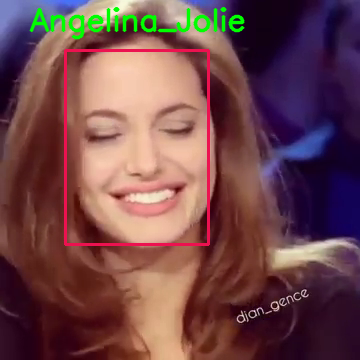

Prediction Probablity:100.000


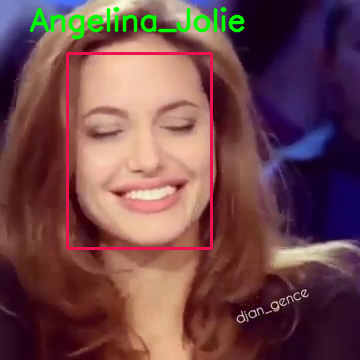

Prediction Probablity:100.000


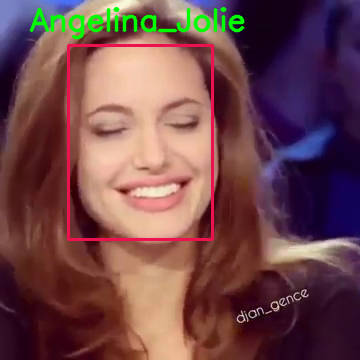

Prediction Probablity:100.000


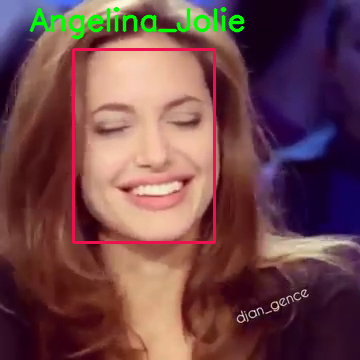

Prediction Probablity:100.000


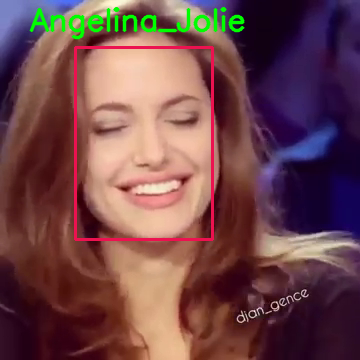

Prediction Probablity:46.012


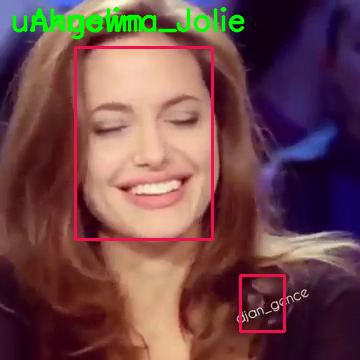

Prediction Probablity:100.000


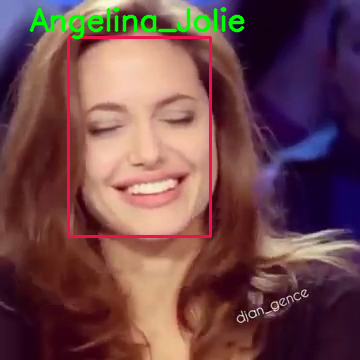

Prediction Probablity:100.000


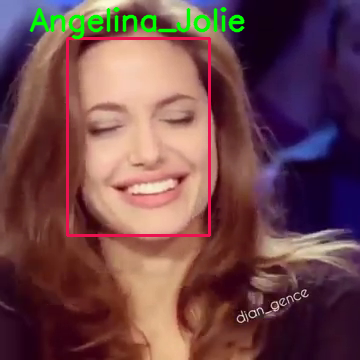

Prediction Probablity:100.000


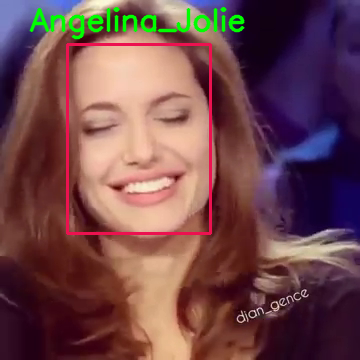

In [ ]:
from numpy import expand_dims
import cv2
from numpy import expand_dims
import pickle
import cv2
from google.colab.patches import cv2_imshow
from mtcnn.mtcnn import MTCNN
from keras.models import load_model
from sklearn.preprocessing import LabelEncoder
from mtcnn.mtcnn import MTCNN
from keras.models import load_model
import numpy as np
from google.colab.patches import cv2_imshow

model = load_model('/content/drive/My Drive/facenet1/facenet_keras.h5')
#print("FaceNet Model Loaded")
emb=[]
names=["Angelina_Jolie","Bill_Gates","John_Snow","Muhammad_Ali","Zinedine_Zidane","elton_john"]
cap = cv2.VideoCapture('/content/driv)
fourcc = cv2.VideoWriter_fourcc(*'XVID') 
out = cv2.VideoWriter('output1.mp4', fourcc,10, (int(cap.get(3)), int(cap.get(4)))) 

# Check if camera opened successfully
if (cap.isOpened()== False): 
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        detector = MTCNN()
        img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        face_locations = detector.detect_faces(img)
        for loc in face_locations:
          x1, y1, width, height = loc['box']
          cv2.rectangle(frame, (x1,y1), (x1+width,y1+height), (80,18,236), 2)
          x1, y1 = abs(x1), abs(y1)
          x2, y2 = x1 + width, y1 + height
          face = frame[y1:y2, x1:x2]
     # print("2. Face extracted")
    #resized for FaceNet model
          face = cv2.resize(face,(160,160))
          face = face.astype('float32')
          mean, std = face.mean(), face.std()
          face = (face - mean) / std
    
          face = expand_dims(face, axis=0)
    #Face embeddings collected
          embed = model.predict(face)
          emb.append(embed)
          filename = 'finalized_model.sav'
          prediction_model = pickle.load(open(filename, 'rb'))
          yhat_class = prediction_model.predict(embed)
    #Retrieving the probability of the prediction
          yhat_prob = prediction_model.predict_proba(embed)
    #print("4. Predicting class and probability done")
    
          class_index = yhat_class[0]
  #print("Index",class_index)
          class_probability = yhat_prob[0,class_index] * 100
          print('Prediction Probablity:%.3f' %(class_probability))
    #setting threshold based on probability
          if(class_probability>99.5):
             cv2.putText(frame ,names[class_index],(30,30), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,0),2,cv2.LINE_AA)
             out.write(frame)
             cv2_imshow(frame)
             cv2.waitKey(0)
          else:
            cv2.putText(frame,"unknown",(10,30), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,0),2,cv2.LINE_AA)
            out.write(frame)
            cv2_imshow(frame)
            cv2.waitKey(0)

          if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break  
cap.release()
out.release()
cv2.destroyAllWindows()